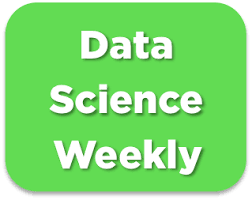

## Importer les librairies 

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder 
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay, accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from xgboost import XGBClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import AdaBoostClassifier

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import plotly.figure_factory as ff

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## lecture du dataset

In [2]:
data=pd.read_csv('conversion_data_train.csv')

## Part: 1 EDA 

In [3]:
data.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


In [4]:
# Basics statistics
print("Number of rows : {}".format(data.shape[0]))
print()

print("Display of dataset: ")
display(data.head())
print()

print("Basics statistics: ")
data_desc = data.describe(include='all')
display(data_desc)
print()

print("Percentage of missing values: ")
display(100*data.isnull().sum()/data.shape[0])

Number of rows : 284580

Display of dataset: 


,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0



Basics statistics: 


,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000



Percentage of missing values: 


country                0.0
age                    0.0
new_user               0.0
source                 0.0
total_pages_visited    0.0
converted              0.0
dtype: float64

pas de valeurs manquantes dans le dataset ! mais allons voir si il y'a des outliers

In [5]:
# voir la distribution de l'age 

fig = px.box(data, y="age")
fig.update_layout(
    title_text='Age distribution',
    height=500,
    width=600
)
fig.show()


on observe des outliers dans la distribution de l'age on va donc s'occuper de les supprimer 

In [6]:
data['age'].sort_values(ascending=False)

233196    123
11331     111
230590     79
268311     77
175251     73
         ... 
114803     17
151330     17
72137      17
151323     17
21340      17
Name: age, Length: 284580, dtype: int64

In [7]:
# Removing age outlier 
outlier_age = data['age'].mean() + data['age'].std()*3

data = data.loc[data['age']<outlier_age,:]

In [8]:
px.box(data, y = 'age', color = 'converted', title = 'répartition des ages  ',width=600, height=400)

In [9]:
px.box(data, y = 'age', color = 'country', title = 'Ages per country in dataset',width=600, height=400)

In [10]:
# Create a pie chart of users by country
fig = px.pie(data, names='country', title='Distribution of users by country')

fig.update_layout(height=500,
                  width=600
)

fig.show()

In [11]:
data.shape

(283563, 6)

etant donné que le dataset est assez grand nous allons faire une partition en sample=1000 en respectant les proportion de la distribution par pays 

In [12]:
China = data[data['country']=='China'].sample(2430, random_state=0)
UK = data[data['country']=='UK'].sample(1530, random_state=0)
Germany = data[data['country']=='Germany'].sample(410, random_state=0)
US = data[data['country']=='US'].sample(5630, random_state=0)

In [13]:
data_sample = pd.concat([US,China,UK,Germany])
data_sample.shape

(10000, 6)

In [14]:
# propotion du taux de conversion 
fig = px.pie(data, 
             names=data['converted'].replace({0:'No',1:'Yes'}), 
             hole=0.3,
             labels={'converted': 'Conversion'})

# Update layout for better appearance
fig.update_layout(
    legend_title_text='Converted',
    title='Conversion proportion in dataset'
)

# Show the plot
fig.show()

In [15]:
#Overall age impact on converting
fig = px.line(data_sample.groupby('age')[['converted']].mean(),line_shape ='spline', 
              markers=True,title='Conversion according to age',
              labels={'value':'conversion','variable':''})
fig.update_layout(showlegend=False)
fig.show()

la conversion d'imminue quand l'age augmente ... cette tendance est elle la meme dans tous les pays ? 

In [16]:
fig = px.box(data_sample, x='country', y='age', color='converted', title = 'Conversion by country according to age')
fig.show()

comme on peut le voir sur ce box la tendance est la meme dans tout les pays il y'a plus de conversion quand on est jeune !

In [17]:
#Age impact on converting by country
fig2 = px.histogram(data_sample, x='country', y='age', color='converted', title = 'Conversion by country according to age')
fig2.show()

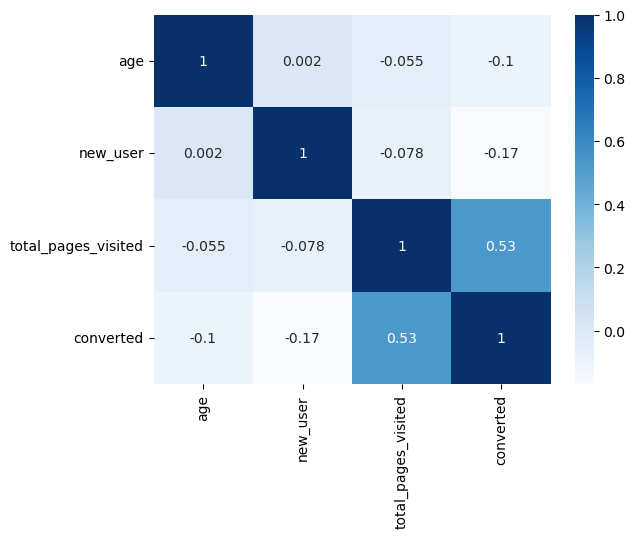

In [44]:
corr = data_sample.corr(numeric_only=True)
sns.heatmap(corr, annot=True, cmap='Blues');

## Part 2 : Model

In [18]:
target= 'converted'
features_list = ['country', 'age', 'new_user', 'source', 'total_pages_visited']

In [19]:
X = data.loc[:, features_list]
Y = data.loc[:, target]

In [20]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0, stratify=Y)
print("...Done.")
print()

Dividing into train and test sets...
...Done.



## pipeline

In [21]:
# Automatically detect names of numeric/categorical columns
numeric_features = []
categorical_features = []
for i,t in X.dtypes.items():
    if ('float' in str(t)) or ('int' in str(t)) :
        numeric_features.append(i)
    else :
        categorical_features.append(i)

print('Found numeric features ', numeric_features)
print('Found categorical features ', categorical_features)

Found numeric features  ['age', 'new_user', 'total_pages_visited']
Found categorical features  ['country', 'source']


In [22]:
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(drop='first')

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

## différents model testing 

In [23]:
# Train model
classifier = LogisticRegression() 
classifier.fit(X_train, Y_train)

# Predictions on training and test sets
Y_train_logreg = classifier.predict(X_train)
Y_test_logreg = classifier.predict(X_test)

print("f1-score on train set : ", f1_score(Y_train, Y_train_logreg))
print("f1-score on test set : ", f1_score(Y_test, Y_test_logreg))

f1-score on train set :  0.7649186256781194
f1-score on test set :  0.7568723274282224


In [24]:
# Train model
xgb = XGBClassifier()
xgb.fit(X_train,Y_train)

# Predictions on training and test sets
Y_train_xgb = xgb.predict(X_train)
Y_test_xgb = xgb.predict(X_test)

print("f1-score on train set : ", f1_score(Y_train, Y_train_xgb))
print("f1-score on test set : ", f1_score(Y_test, Y_test_xgb))

f1-score on train set :  0.7762001352265044
f1-score on test set :  0.7525962125839952


In [25]:
# Train model
randomforest = RandomForestClassifier()
randomforest.fit(X_train,Y_train)

# Predictions on training and test sets
Y_train_rf = randomforest.predict(X_train)
Y_test_rf = randomforest.predict(X_test)

print("f1-score on train set : ", f1_score(Y_train, Y_train_rf))
print("f1-score on test set : ", f1_score(Y_test, Y_test_rf))

f1-score on train set :  0.8043608124253285
f1-score on test set :  0.736746440472584


le XgB et la logistic regression sont  les meuilleurs modèles 

In [26]:
voting = VotingClassifier(estimators=[
         ('logreg', classifier), ('xgb', xgb),('randomforest',randomforest)],
        voting='soft',verbose=True)
voting = voting.fit(X_train, Y_train)
Y_train_pred = voting.predict(X_train)
Y_test_pred = voting.predict(X_test)
print("f1-score on train set : ", f1_score(Y_train, Y_train_pred))
print("f1-score on test set : ", f1_score(Y_test, Y_test_pred))

[Voting] ................... (1 of 3) Processing logreg, total=   0.4s
[Voting] ...................... (2 of 3) Processing xgb, total=   0.7s
[Voting] ............. (3 of 3) Processing randomforest, total=  13.6s
f1-score on train set :  0.7867718902668169
f1-score on test set :  0.7548091603053435


## gridsearch pour les  modèles de XGB et logistic regression

In [27]:
import time

In [28]:
# parameters
start_time = time.time()
logreg = LogisticRegression()
params = {
    'solver': ['saga', 'lbfgs','sag'],
    'penalty':['l2'],
    'C' : [1000, 100, 10, 1, 0.1]
}
#grid search
gridsearch = GridSearchCV(logreg, param_grid=params, cv=5,scoring='f1')
gridsearch.fit(X_train, Y_train)
#Print the best parameters
print("Best parameters :",  gridsearch.best_params_)
end_time = time.time()
elapsed_time = end_time - start_time
print(elapsed_time/60,"minutes")


Best parameters : {'C': 10, 'penalty': 'l2', 'solver': 'saga'}
2.093202539285024 minutes


In [29]:
# Train model
start_time = time.time()
classifier = LogisticRegression(C=100, solver='saga', penalty='l2') 
classifier.fit(X_train, Y_train)

# Predictions on training and test sets
Y_train_logreg = classifier.predict(X_train)
Y_test_logreg = classifier.predict(X_test)

print("f1-score on train set : ", f1_score(Y_train, Y_train_logreg))
print("f1-score on test set : ", f1_score(Y_test, Y_test_logreg))
end_time = time.time()
elapsed_time = end_time - start_time
print(elapsed_time/60,"minutes")

f1-score on train set :  0.7651754782346739
f1-score on test set :  0.7572519083969466
0.04530202547709147 minutes


In [30]:
# parameters
start_time = time.time()
xgb = XGBClassifier()
params = {
        'min_child_weight': [2,4,6,8],
        'n_estimators': [10,50,100],
        'gamma': [0, 0.5, 1, 1.5,2],
        'max_depth': [4,6,8,10],
        
}
#grid search
gridsearch = GridSearchCV(xgb, param_grid=params, cv=5,scoring='f1')
gridsearch.fit(X_train, Y_train)

#Print the best parameters
print("Best parameters :",  gridsearch.best_params_)
elapsed_time = end_time - start_time
print(elapsed_time)

Best parameters : {'gamma': 0, 'max_depth': 4, 'min_child_weight': 4, 'n_estimators': 50}
-0.026713848114013672


In [31]:
import time

In [32]:
# Train model
start_time = time.time()
xgb = XGBClassifier(max_depth= 4, n_estimators = 50, min_child_weight= 4,gamma=0)
xgb.fit(X_train, Y_train)

# Predictions on training and test sets
Y_train_xgb = xgb.predict(X_train)
Y_test_xgb = xgb.predict(X_test)

print("f1-score on train set : ", f1_score(Y_train, Y_train_xgb))
print("f1-score on test set : ", f1_score(Y_test, Y_test_xgb))
end_time = time.time()
elapsed_time = end_time - start_time
print(elapsed_time)

f1-score on train set :  0.7692768378499776
f1-score on test set :  0.7598173515981737
0.7651872634887695


on vois que la girdsearch ne nous a pas forcément montrer une amelioration du f1-score

## matrice de confusion

### matrice de confusion pour le model XGB 

matrice de confusion pour le train set : 


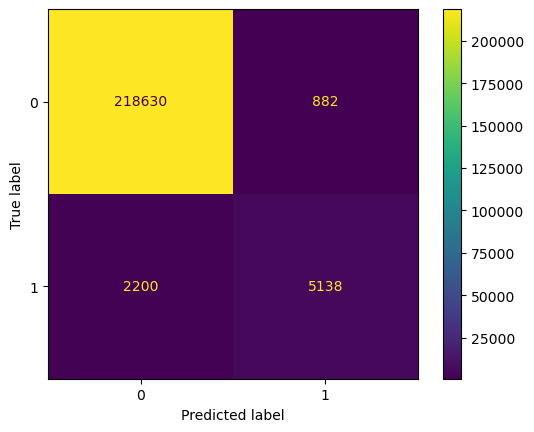

f1-score  train set :  0.7692768378499776


In [33]:
print("matrice de confusion pour le train set : ")
cm = confusion_matrix(Y_train, Y_train_xgb, labels=xgb.classes_)
cm_display = ConfusionMatrixDisplay.from_predictions(Y_train, Y_train_xgb)

plt.show()

print("f1-score  train set : ", f1_score(Y_train, Y_train_xgb))

matrice de confusion pour le  test set : 


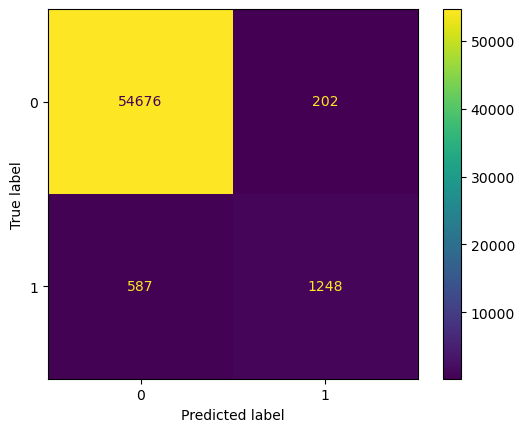

f1-score  test set :  0.7598173515981737


In [34]:
print("matrice de confusion pour le  test set : ")
cm = confusion_matrix(Y_test, Y_test_xgb, labels=xgb.classes_)
cm_display = ConfusionMatrixDisplay.from_predictions(Y_test, Y_test_xgb)
plt.show() 
print("f1-score  test set : ", f1_score(Y_test, Y_test_xgb))

### matrice de confusion pour le model logistic regression 

matrice de confusion pour le train set : 


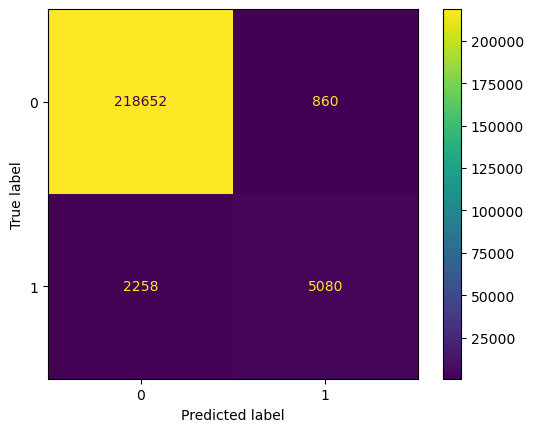

f1-score on train set :  0.7651754782346739


In [35]:
print("matrice de confusion pour le train set : ")
cm = confusion_matrix(Y_train, Y_train_logreg, labels=classifier.classes_)
cm_display = ConfusionMatrixDisplay.from_predictions(Y_train, Y_train_logreg)
plt.show() 
print("f1-score on train set : ", f1_score(Y_train, Y_train_logreg))

matrice de confusion pour le test set : 


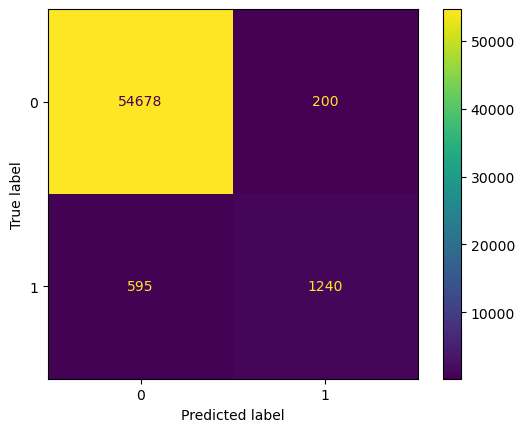

f1-score on test set :  0.7572519083969466


In [36]:
print("matrice de confusion pour le test set : ")
cm = confusion_matrix(Y_test, Y_test_logreg, labels=classifier.classes_)
cm_display = ConfusionMatrixDisplay.from_predictions(Y_test, Y_test_logreg)
plt.show() 
print("f1-score on test set : ", f1_score(Y_test, Y_test_logreg))

In [37]:
# Concatenate our train and test set to train your best classifier on all data with labels
X = np.append(X_train,X_test,axis=0)
Y = np.append(Y_train,Y_test)

classifier.fit(X,Y)

LogisticRegression(C=100, solver='saga')

In [38]:
# Read data without labels
data_without_labels = pd.read_csv('conversion_data_test.csv')
print('Prediction set (without labels) :', data_without_labels.shape)

# Warning : check consistency of features_list (must be the same than the features 
# used by your best classifier)
features_list = ['country', 'age', 'new_user', 'source', 'total_pages_visited']
X_without_labels = data_without_labels.loc[:, features_list]

Prediction set (without labels) : (31620, 5)


In [39]:
print("Encoding categorical features and standardizing numerical features...")

X_without_labels = preprocessor.transform(X_without_labels)
print("...Done")
print(X_without_labels[0:5,:])

Encoding categorical features and standardizing numerical features...
...Done
[[-0.30274697 -1.47565965  3.32444027  0.          1.          0.
   0.          1.        ]
 [-1.04261259  0.67766304  0.03638491  0.          1.          0.
   1.          0.        ]
 [ 0.19049678  0.67766304 -1.15927159  0.          0.          0.
   0.          1.        ]
 [ 0.19049678  0.67766304  0.33529903  0.          0.          1.
   0.          0.        ]
 [-0.67267978 -1.47565965 -0.56144334  0.          0.          0.
   0.          1.        ]]


In [40]:
# save in csv 
data = {
    'converted': classifier.predict(X_without_labels)
}

Y_predictions = pd.DataFrame(columns=['converted'],data=data)
Y_predictions.to_csv('conversion_data_test_predictions_walid_khaldi.csv', index=False)

### Conclusion 

Tous les modèles testés ont donné de bons résultats !


**EDA :**  
- L’âge est un enjeu majeur. Les personnes âgées ne se convertissent pas.  
- Cibler les nouveaux utilisateurs ne semble pas pertinent étant donné qu’ils ont tendance à convertir beaucoup moins que les anciens utilisateurs.
- Plus nous passons de temps (total_pages_visited) plus nous obtenons de conversions.  
- Les Allemands obtiennent le taux de conversion le plus élevé parmi tous les autres pays.
    
**Analyse du modèle** : 
- Certains modèles et hyperparamètres ont été ignorés en raison du temps considérable nécessaire pour les exécuter.  
- Essayer d’autres hyperparamètres pourrait améliorer les résultats.  